# Deep Learning for CV - Building a CNN

In [1]:
from __future__ import absolute_import, division, print_function, unicode_literals
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import datetime
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras.utils import np_utils
from tensorboard.plugins.hparams import api as hp

In [2]:
mnist = keras.datasets.mnist 
(x_train, y_train), (x_test, y_test) = mnist.load_data()

11493376/11490434 [==============================] - 0s 0us/step


In [3]:
# convert MINIST Dataset 3d dimention to 4d because keras required 4d input for convolution operation
# MINIST image depth will include as new dimention. Since it has grayscale depth is 1

x_train = x_train.reshape((x_train.shape[0], 28, 28, 1))
x_test = x_test.reshape((x_test.shape[0], 28, 28, 1))

In [4]:
#Normalization - Rescaling pixels on scale 0 to 1
x_train = x_train / 255.0
x_test = x_test / 255.0

In [5]:
#initializing Tensorboard extension
%load_ext tensorboard
#creating a logs directory
#log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

In [6]:
# Clear any logs from previous runs
!rm -rf ./logs/ 

In [7]:
HP_NUM_UNITS_1 = hp.HParam('num_units_1', hp.Discrete([16,32,64]))
HP_NUM_UNITS_2 = hp.HParam('num_units_2', hp.Discrete([16,32,64]))
HP_NUM_UNITS_3 = hp.HParam('num_units_3', hp.Discrete([32,64]))
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.1, 0.2))
HP_OPTIMIZER = hp.HParam('optimizer', hp.Discrete(['adam']))

METRIC_ACCURACY = 'accuracy'

with tf.summary.create_file_writer('logs/hparam_tuning').as_default():
  hp.hparams_config(
    hparams=[HP_NUM_UNITS_1,HP_NUM_UNITS_2, HP_DROPOUT,HP_NUM_UNITS_3, HP_OPTIMIZER],
    metrics=[hp.Metric(METRIC_ACCURACY, display_name='Accuracy')],
  )


In [8]:
def train_test_model(hparams):
  # number of possible label values
  model = Sequential()
  #input_shape = (height,width,channels)
  # Here batch size will be None at the beginng at later when we fit the model it will be used
  model.add(Conv2D(hparams[HP_NUM_UNITS_1],kernel_size =(3,3),activation ='relu', padding='same', input_shape=(28, 28,1)))
  model.add(Conv2D(hparams[HP_NUM_UNITS_2], kernel_size=(3,3), activation='relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))
  model.add(Dropout(hparams[HP_DROPOUT]))
  #flatted 3d ouput to 1d
  model.add(Flatten())
  model.add(Dense(hparams[HP_NUM_UNITS_3], activation='relu'))
  model.add(Dense(hparams[HP_NUM_UNITS_3], activation='relu'))
  # Output clasess =10 Hence used 10 outputs in Dense layer
  model.add(Dense(10, activation='softmax'))

 
  model.compile(
      optimizer=hparams[HP_OPTIMIZER],
      loss='sparse_categorical_crossentropy',
      metrics=['accuracy'],
  )

  model.fit(x_train, y_train, epochs=3) 
  _, accuracy = model.evaluate(x_test, y_test)
  return accuracy

In [9]:
def run(run_dir, hparams):
  with tf.summary.create_file_writer(run_dir).as_default():
    hp.hparams(hparams)  # record the values used in this trial
    accuracy = train_test_model(hparams)
    tf.summary.scalar(METRIC_ACCURACY, accuracy, step=1)


In [10]:
session_num = 0
for num_units_1 in HP_NUM_UNITS_1.domain.values:
  for num_units_2 in HP_NUM_UNITS_2.domain.values:
    for dropout_rate in (HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value):
      for num_units_3 in HP_NUM_UNITS_3.domain.values:
         hparams = {
            HP_NUM_UNITS_1: num_units_1,
            HP_NUM_UNITS_2: num_units_2,
            HP_DROPOUT: dropout_rate,
            HP_NUM_UNITS_3: num_units_3,
            HP_OPTIMIZER: 'adam',
         }
         run_name = "run-%d" % session_num
         print('--- Starting trial: %s' % run_name)
         print({h.name: hparams[h] for h in hparams})
         run('logs/hparam_tuning/' + run_name, hparams)
         session_num += 1


--- Starting trial: run-0
{'num_units_1': 16, 'num_units_2': 16, 'dropout': 0.1, 'num_units_3': 32, 'optimizer': 'adam'}
Epoch 1/3
1875/1875 [==============================] - 53s 20ms/step - loss: 0.4549 - accuracy: 0.8562
Epoch 2/3
1875/1875 [==============================] - 37s 20ms/step - loss: 0.0820 - accuracy: 0.9749
Epoch 3/3
313/313 [==============================] - 3s 7ms/step - loss: 0.0378 - accuracy: 0.9889
--- Starting trial: run-1
{'num_units_1': 16, 'num_units_2': 16, 'dropout': 0.1, 'num_units_3': 64, 'optimizer': 'adam'}
Epoch 1/3
1875/1875 [==============================] - 39s 20ms/step - loss: 0.3615 - accuracy: 0.8862
Epoch 2/3
1875/1875 [==============================] - 39s 21ms/step - loss: 0.0556 - accuracy: 0.9824
Epoch 3/3
313/313 [==============================] - 2s 7ms/step - loss: 0.0443 - accuracy: 0.9869
--- Starting trial: run-2
{'num_units_1': 16, 'num_units_2': 16, 'dropout': 0.2, 'num_units_3': 32, 'optimizer': 'adam'}
Epoch 1/3
1875/1875 [======

In [11]:
%tensorboard --logdir logs/hparam_tuning

<IPython.core.display.Javascript object>

In [13]:
 # number of possible label values
model = Sequential()
  #input_shape = (height,width,channels)
  # Here batch size will be None at the beginng at later when we fit the model it will be used
model.add(Conv2D(32,kernel_size =(3,3),activation ='relu', padding='same', input_shape=(28, 28,1)))
model.add(Conv2D(32, kernel_size=(3,3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.2))
#flatted 3d ouput to 1d
model.add(Flatten())
model.add(Dense(32, activation='relu'))
model.add(Dense(32, activation='relu'))
# Output clasess =10 Hence used 10 outputs in Dense layer
model.add(Dense(10, activation='softmax'))
model.summary()

Model: "sequential_36"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_72 (Conv2D)           (None, 28, 28, 32)        320       
_________________________________________________________________
conv2d_73 (Conv2D)           (None, 26, 26, 32)        9248      
_________________________________________________________________
max_pooling2d_36 (MaxPooling (None, 13, 13, 32)        0         
_________________________________________________________________
dropout_36 (Dropout)         (None, 13, 13, 32)        0         
_________________________________________________________________
flatten_36 (Flatten)         (None, 5408)              0         
_________________________________________________________________
dense_108 (Dense)            (None, 32)                173088    
_________________________________________________________________
dense_109 (Dense)            (None, 32)              

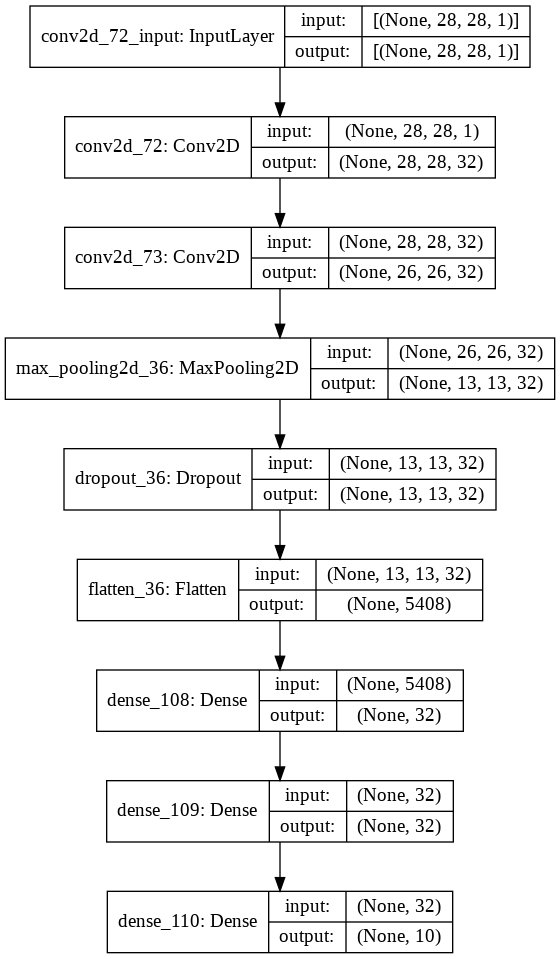

In [14]:
from keras.utils.vis_utils import plot_model
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [15]:
model.compile(optimizer= 'adam',loss='sparse_categorical_crossentropy',  metrics=['accuracy'])
#tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)

In [16]:

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

model.fit(x_train, 
          y_train, 
          validation_split=0.2,
          epochs=10,  
          callbacks=[tensorboard_callback])

Epoch 1/10
1500/1500 [==============================] - 58s 38ms/step - loss: 0.4340 - accuracy: 0.8680 - val_loss: 0.0817 - val_accuracy: 0.9755
Epoch 2/10
1500/1500 [==============================] - 54s 36ms/step - loss: 0.0770 - accuracy: 0.9770 - val_loss: 0.0705 - val_accuracy: 0.9801
Epoch 3/10
1500/1500 [==============================] - 54s 36ms/step - loss: 0.0515 - accuracy: 0.9845 - val_loss: 0.0486 - val_accuracy: 0.9854
Epoch 4/10
1500/1500 [==============================] - 54s 36ms/step - loss: 0.0377 - accuracy: 0.9878 - val_loss: 0.0517 - val_accuracy: 0.9852
Epoch 5/10
1500/1500 [==============================] - 54s 36ms/step - loss: 0.0274 - accuracy: 0.9917 - val_loss: 0.0472 - val_accuracy: 0.9859
Epoch 6/10
1500/1500 [==============================] - 54s 36ms/step - loss: 0.0260 - accuracy: 0.9910 - val_loss: 0.0436 - val_accuracy: 0.9881
Epoch 7/10
1500/1500 [==============================] - 54s 36ms/step - loss: 0.0196 - accuracy: 0.9938 - val_loss: 0.0494 -

In [18]:
# plt.plot(model.history.history['accuracy'], label=['Accuracy'])
# plt.plot(model.history.history['loss'],label =['Loss'])
# plt.xlabel('Epoch')
# plt.ylabel('Accuracy/ Loss')
# plt.ylim([0.5, 2])
# plt.legend(loc='upper left')
# plt.show()


test_loss, test_acc = model.evaluate(x_test, y_test)

print('Test Accuracy',test_acc)
print('\nTest loss:', test_loss)

313/313 [==============================] - 3s 10ms/step - loss: 0.0478 - accuracy: 0.9872
Test Accuracy 0.9872000217437744

Test loss: 0.04780405014753342


In [19]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [20]:
# predicting on the test data
y_pred = model.predict(x_test)

[4.5562766e-17 2.6714964e-10 5.9752610e-13 1.0281449e-08 1.4678750e-05
 9.0842045e-09 6.0565212e-17 1.5388780e-08 4.1803919e-08 9.9998534e-01]
9
tested 9
9
predicted 9


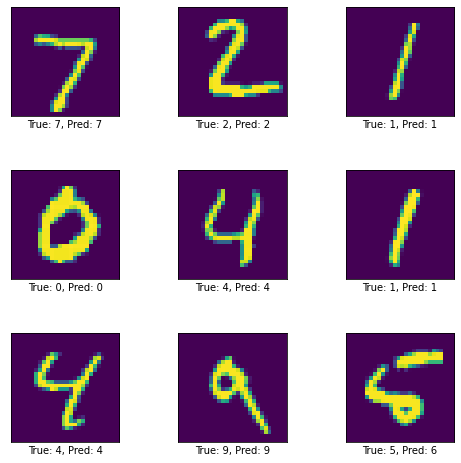

In [33]:
i=20
print(y_pred[i])
print(y_test[i])
#t=y_test[i]
#print('t', t)
#print(t[0])
print("tested", y_test[i])
print(np.argmax(y_pred[i]))
print("predicted" , np.argmax(y_pred[i]))

fig, axes = plt.subplots(3, 3, figsize=(8,8))
fig.subplots_adjust(hspace=0.5, wspace=0.5)

for i, ax in enumerate(axes.flat):
  ax.imshow(x_test[i].reshape(28,28))
  xlabel = "True: {0}, Pred: {1}".format(y_test[i],np.argmax(y_pred[i])) 
  ax.set_xlabel(xlabel)
  ax.set_xticks([])
  ax.set_yticks([])

plt.show()